In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import time
import os

import dogs_vs_cats.testing as testing
import dogs_vs_cats.dataset as dataset
import dogs_vs_cats.train_model as train_model
import dogs_vs_cats.preprocessing as preprocessing
import dogs_vs_cats.reporting as reporting

Using Theano backend.
Using gpu device 0: GeForce GTX 850M (CNMeM is disabled)


# Get model

In [2]:
model, path = testing.get_model("dogs_vs_cats/experiments/blog_post_5_scale_invariant/vggnet_with_BN_RGB_window_46_v2_512/MEM_1")

C:\Python27\lib\site-packages\keras-0.3.2-py2.7.egg\keras\models.py:495: UserWarning: The "class_mode" argument is deprecated, please remove it from your code.
  warnings.warn('The "class_mode" argument is deprecated, please remove it from your code.')


# Datastream

In [3]:
train_dataset = dataset.FuelDataset("train", (150,150,3), batch_size=32)

# Get_grads function

Gradients wrt to the input

In [7]:
from keras import backend as K

input_ = model.layers[0].input
y_ = model.y
layer_output = model.layers[-1].get_output()
xent = K.categorical_crossentropy(y_, layer_output)
loss = xent.mean()
grads = K.gradients(loss, input_)
get_grads = K.function([input_, y_], [loss, grads])

# Adversarial examples demo

In [30]:
# Get batch
batch, labels = train_dataset.get_batch()
# Model prediction
preds = model.predict(batch.transpose(0,3,1,2))
# Get gradients wrt the input
l, grads = get_grads([batch.transpose(0,3,1,2), testing.convert_labels(labels)])
# Create adversarial example
updates = np.sign(grads).transpose(0,2,3,1)
adversarials = batch + updates
# Model prediction
adv_preds = model.predict(adversarials.transpose(0,3,1,2))

# Plot

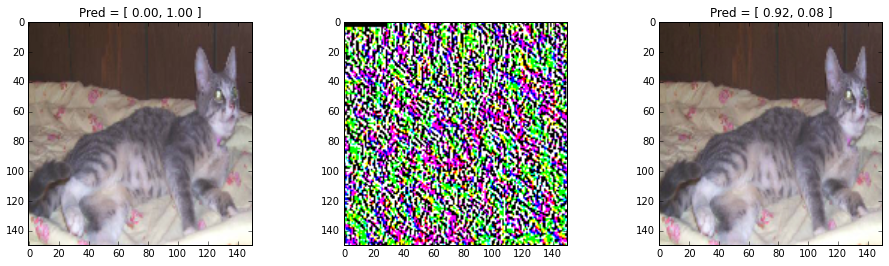

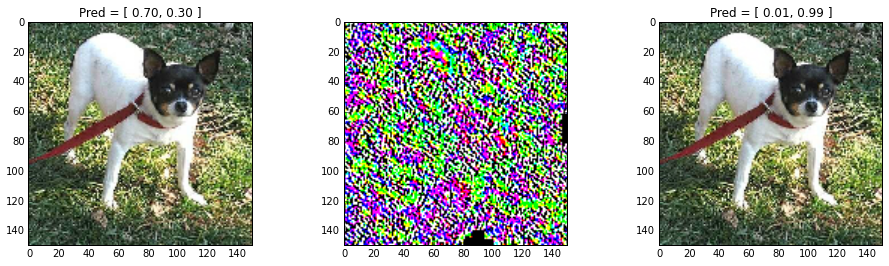

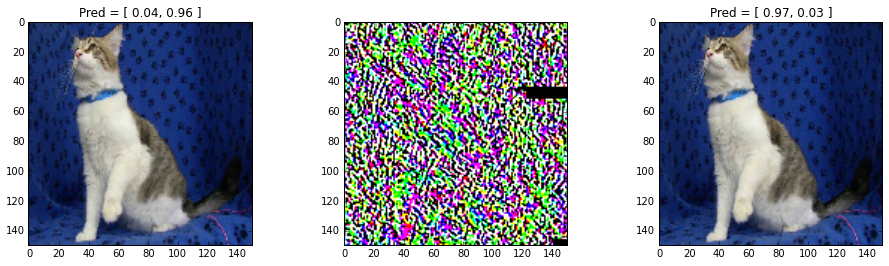

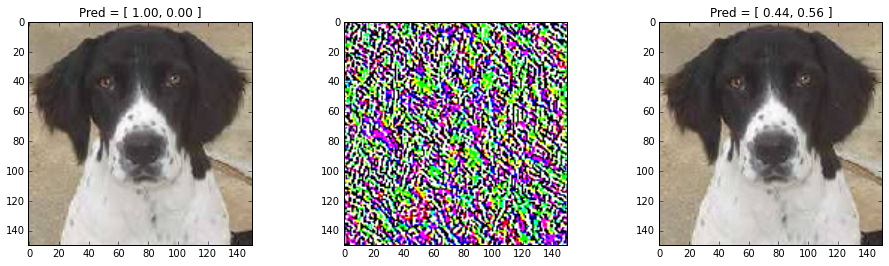

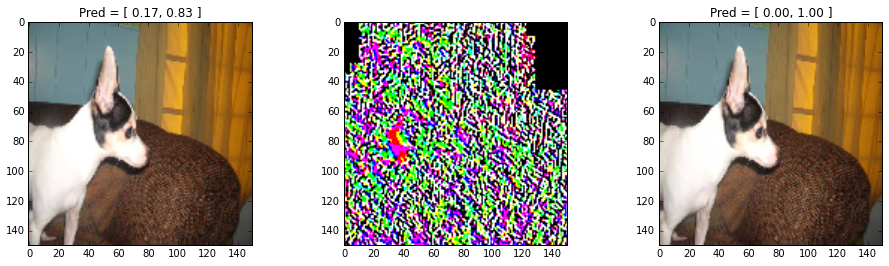

...

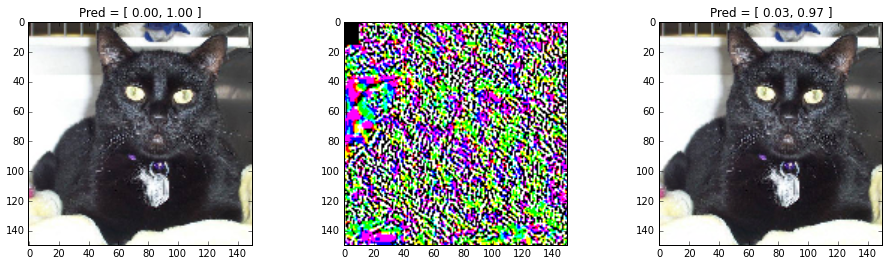

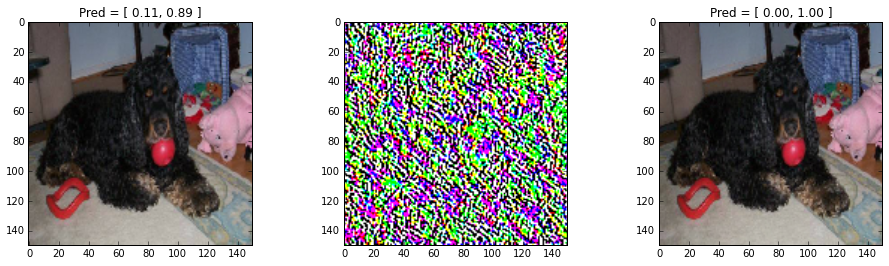

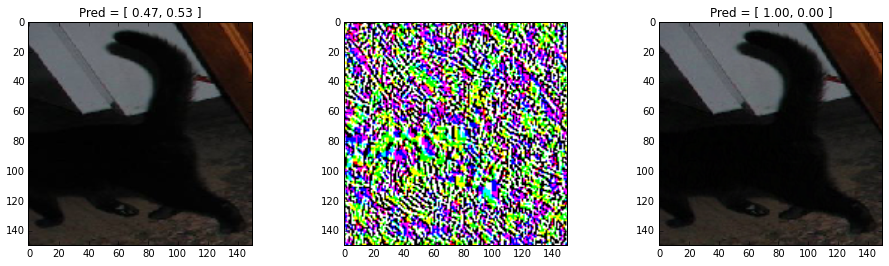

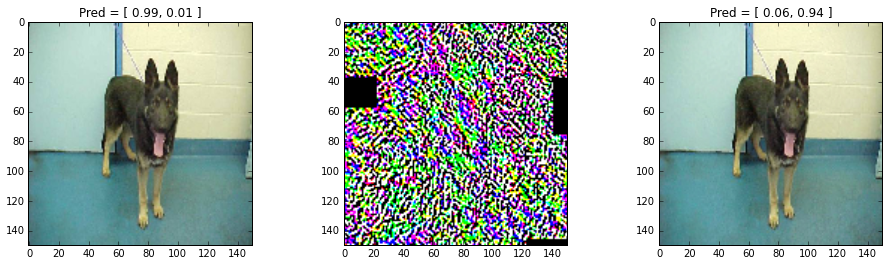

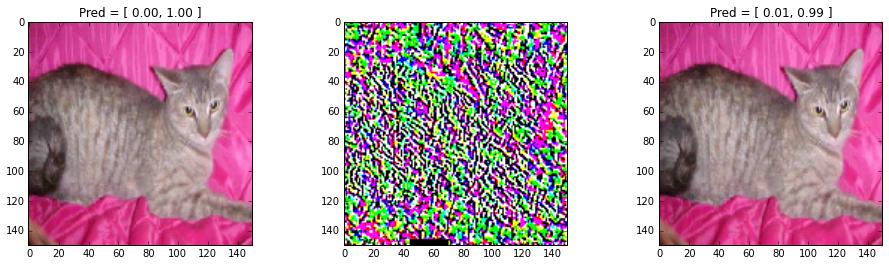

In [31]:
for n in range(32):
    plt.figure(figsize=(16,4))
    plt.subplot(1,3,1)
    plt.title("Pred = [ %.2f, %.2f ]"%(preds[n][0], preds[n][1]))
    plt.imshow(batch[n].astype("uint8"))
    plt.subplot(1,3,2)
    plt.imshow(grads[n])
    plt.subplot(1,3,3)
    plt.title("Pred = [ %.2f, %.2f ]"%(adv_preds[n][0], adv_preds[n][1]))
    plt.imshow(np.clip(adversarials[n], 0, 255).astype("uint8"))
    plt.show()

## Plotting grads (!= perturbation = sign(grads))

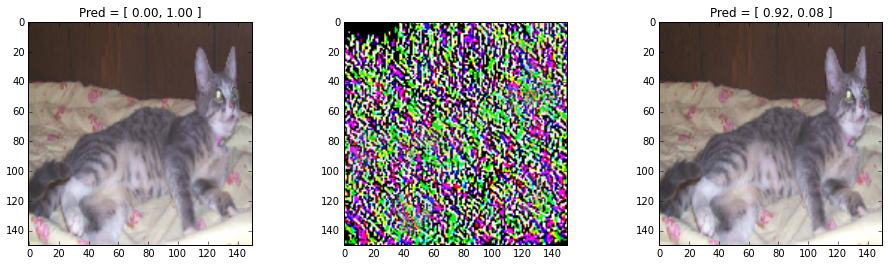

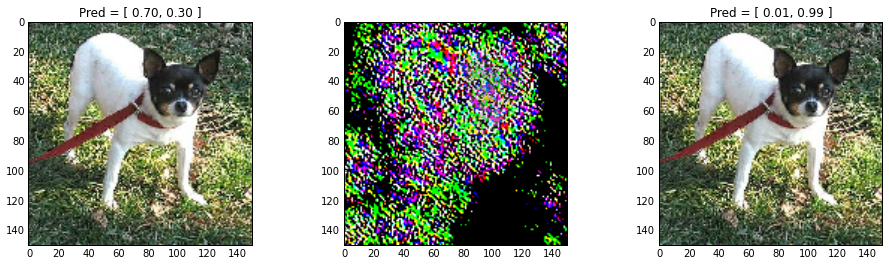

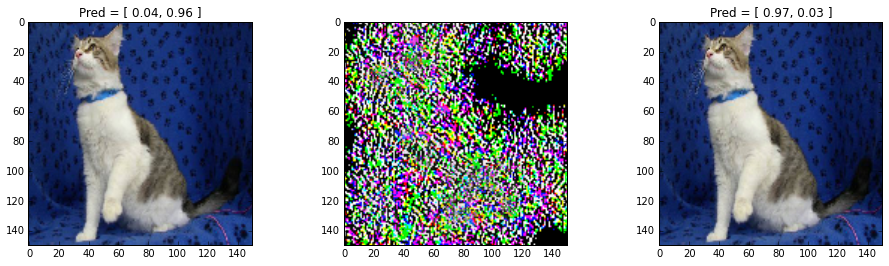

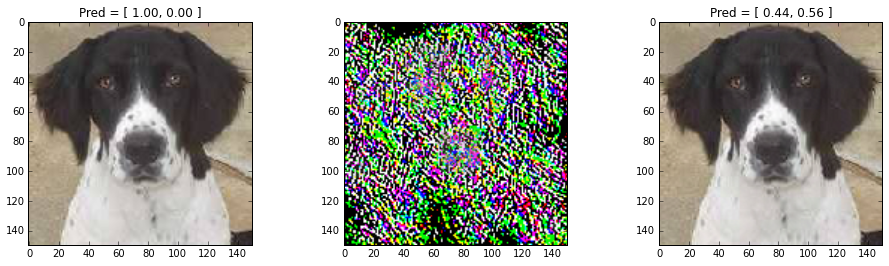

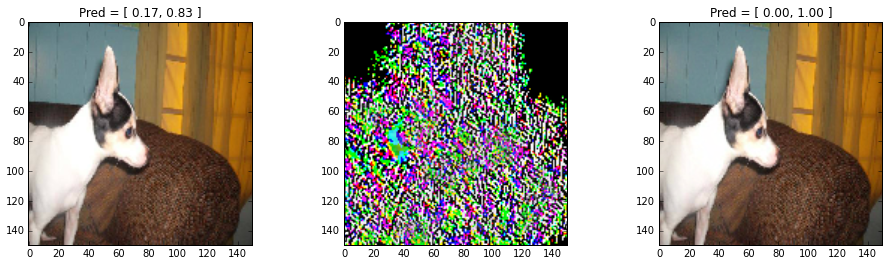

...

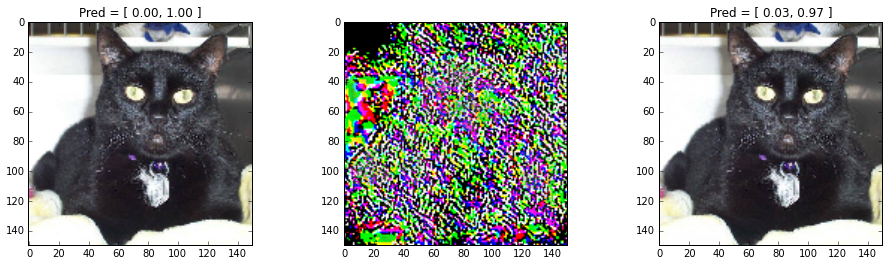

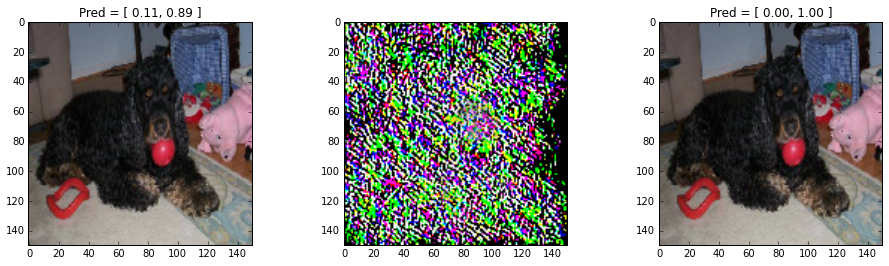

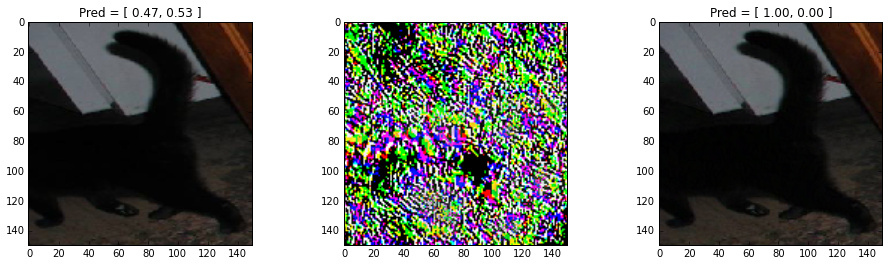

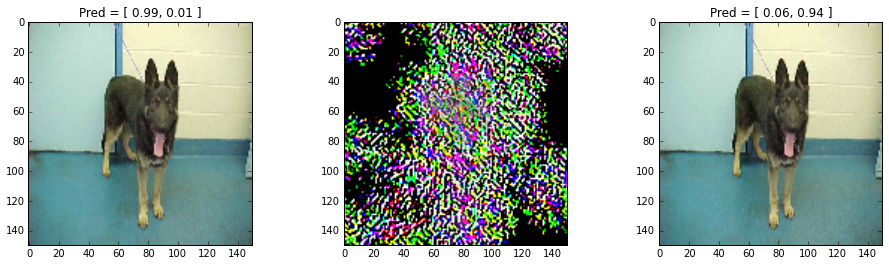

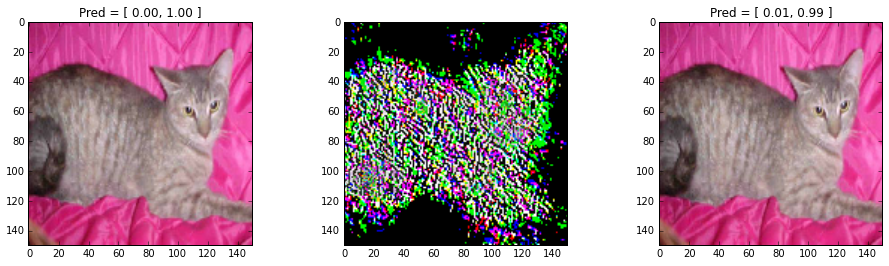

In [35]:
for n in range(32):
    plt.figure(figsize=(16,4))
    plt.subplot(1,3,1)
    plt.title("Pred = [ %.2f, %.2f ]"%(preds[n][0], preds[n][1]))
    plt.imshow(batch[n].astype("uint8"))
    plt.subplot(1,3,2)
    plt.imshow(grads[n].transpose(1,2,0)/grads[n].max())
    plt.subplot(1,3,3)
    plt.title("Pred = [ %.2f, %.2f ]"%(adv_preds[n][0], adv_preds[n][1]))
    plt.imshow(np.clip(adversarials[n], 0, 255).astype("uint8"))
    plt.show()